In [1]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from urllib.request import urlopen
import json

import itertools

from time import time
from datetime import datetime, timedelta
from pytz import timezone

import plotly.graph_objects as go
import plotly.express as px
import plotly.offline as po
from plotly.subplots import make_subplots

from shapely.geometry import Polygon, MultiPolygon

# load joined dataframe and county json

In [5]:
def optimize(df):
    
    # converts to datetime if possible
    df = df.apply(lambda col: pd.to_datetime(col, errors='ignore') if col.dtypes=='object' else col)
    
    # if there are less than half as many unique values as there are rows, convert to category
    for col in df.select_dtypes(include='object'):
        if len(df[col].unique()) / len(df[col]) < 0.5:
            df[col] = df[col].astype('category')
    
    # downcasts numeric columns if possible
    df = df.apply(lambda col: pd.to_numeric(col, downcast='integer') if col.dtypes=='int64' else col)
    df = df.apply(lambda col: pd.to_numeric(col, downcast='float') if col.dtypes=='float64' else col)
    
    return df

In [8]:
df = optimize(pd.read_csv('data/df.csv'))
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 310345 entries, 0 to 310344
Data columns (total 38 columns):
 #   Column                        Non-Null Count   Dtype         
---  ------                        --------------   -----         
 0   date                          310345 non-null  datetime64[ns]
 1   county                        310345 non-null  category      
 2   state                         310345 non-null  category      
 3   fips                          310345 non-null  category      
 4   cases                         310345 non-null  int32         
 5   deaths                        310345 non-null  int16         
 6   area                          310345 non-null  float32       
 7   population                    310345 non-null  int32         
 8   lat                           310345 non-null  float32       
 9   lon                           310345 non-null  float32       
 10  cases_per_100k                310345 non-null  float32       
 11  deaths_per_10

In [14]:
with open('data/county_json.json') as f:
    county_json = json.load(f)

# current maps

## setting `yesterday` and making a slice

In [9]:
la = timezone('US/Pacific')
yesterday = (datetime.now(la) - timedelta(1)).strftime('%Y-%m-%d')
two_weeks = (datetime.now(la) - timedelta(15)).strftime('%Y-%m-%d')
day_of_week = df[df['date'] == yesterday]['date'].dt.dayofweek.unique()[0]

In [10]:
yesterday_df = df[df['date'] == yesterday]

## total cases to-date

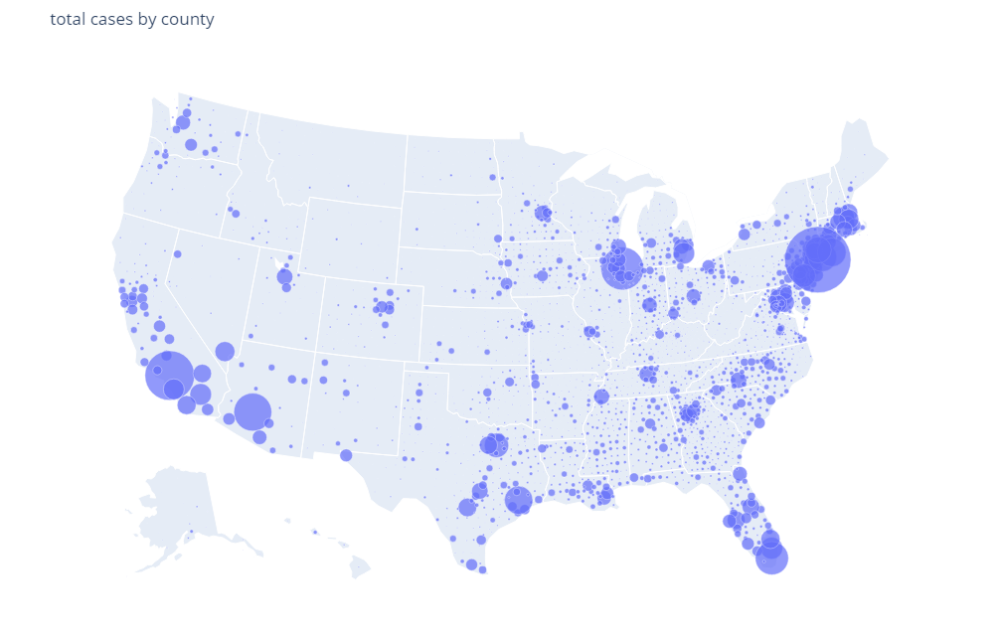

In [52]:
col = 'cases'
colname = 'cases'
tickvals = np.sqrt([25_000, 100_000, 200_000])
ticktext = ['25k', '100k', '200k']
title_text = 'total cases by county'

# yesterday_df.loc[:, 'total cases text'] = yesterday_df['county'].astype('str') + '<br>Cases: ' + yesterday_df['cases'].astype(str)

fig = go.Figure(
    data=go.Scattergeo(
        locationmode = 'geojson-id',
        lon=yesterday_df['lon'],
        lat=yesterday_df['lat'],
#         text=yesterday_df['total cases text'],
        mode='markers',
        marker=dict(
            size=yesterday_df[col]/100,
            line={
                'width':0.5,
                'color':'rgb(255,255,255)'
            },
            sizemode='area'
        ),
        
    )
 )

fig.update_layout(
    title_text=title_text,
    geo_scope='usa',
    height=640,
    width=1080,
    margin={"r":10,"t":50,"l":10,"b":20, 'pad':4}
)

fig.show()

## new cases (7-day rolling average)

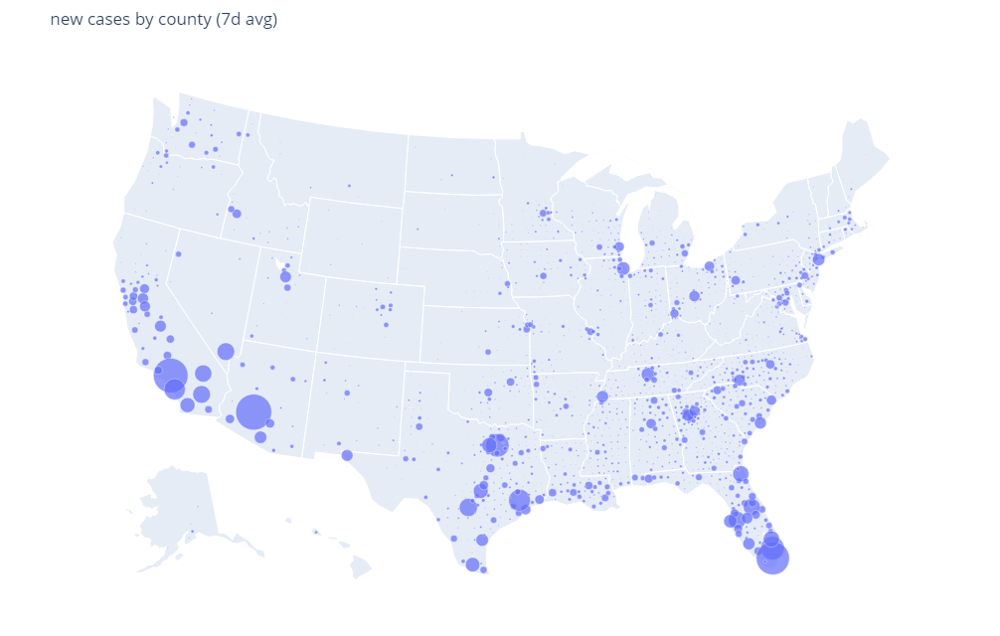

In [53]:
col = 'new_cases_7d'
colname = 'new cases'
# tickvals = np.sqrt([25_000, 100_000, 200_000])
# ticktext = ['25k', '100k', '200k']
title_text = 'new cases by county (7d avg)'

# z1 = np.percentile(yesterday_df['delta_new_cases_7d'], 1)
# z99 = np.percentile(yesterday_df['delta_new_cases_7d'], 99)
# zmax = np.max([np.abs(z1), np.abs(z99)])
# zmax = zmax + (-zmax) % 10

# yesterday_df.loc[:, 'total cases text'] = yesterday_df['county'].astype('str') + '<br>Cases: ' + yesterday_df['cases'].astype(str)

fig = go.Figure(
    data=go.Scattergeo(
        locationmode = 'geojson-id',
        lon=yesterday_df['lon'],
        lat=yesterday_df['lat'],
#         text=yesterday_df['total cases text'],
        marker=dict(
            size=yesterday_df[col]/4,
            line=dict(
                width=0.5,
                color='rgb(255,255,255)'
            ),
#             colorscale='RdBu_r',
#             color=yesterday_df['delta_new_cases_7d'],
#             cmid=0,
#             colorbar_title='change in new cases (7d avg)',
            sizemode='area'
        ),
        
    )
 )

fig.update_layout(
#     showlegend=True,
    title_text=title_text,
    geo_scope='usa',
    height=640,
    width=1080,
    margin={"r":10,"t":50,"l":10,"b":20, 'pad':4}
)

fig.show()

## change in new cases (7-day rolling average)

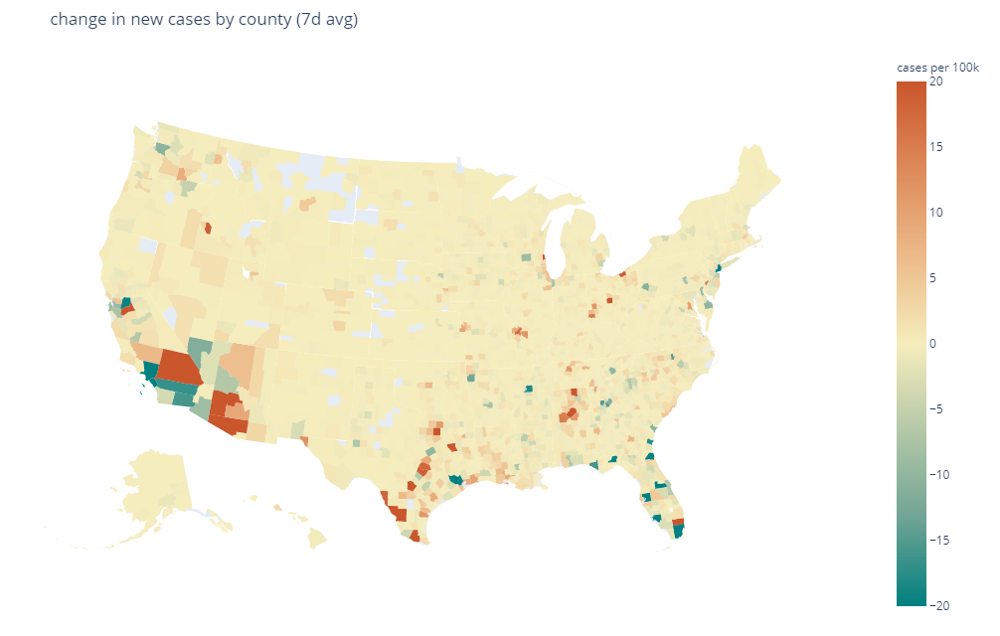

In [65]:
col = 'delta_new_cases_7d'
colname = 'cases per 100k'

z1 = np.percentile(yesterday_df[col], 1)
z99 = np.percentile(yesterday_df[col], 99)
zmax = np.max([np.abs(z1), np.abs(z99)])
zmax = zmax + (-zmax) % 10
# tickvals = np.sqrt([25_000, 100_000, 200_000])
# ticktext = ['25k', '100k', '200k']
title_text = 'change in new cases by county (7d avg)'

fig = go.Figure(
    data=go.Choropleth(
        colorscale='geyser',
        colorbar=dict(
            title=colname,
#             tickvals=tickvals,
#             ticktext=ticktext
        ),
        locations=yesterday_df['fips'],
        geojson=county_json,
        marker=dict(
            line={'width':0}
        ),
        z = yesterday_df[col],
        zmin=-zmax,
        zmid=0,
        zmax=zmax,
        zauto=False,
        locationmode = 'geojson-id',
        
    )
 )

fig.update_layout(
    title_text=title_text,
    geo_scope='usa',
    height=640,
    width=1080,
    margin={"r":10,"t":50,"l":10,"b":20, 'pad':4}
)

fig.show()

In [70]:
miami = df[df['county'] == 'Miami-Dade']

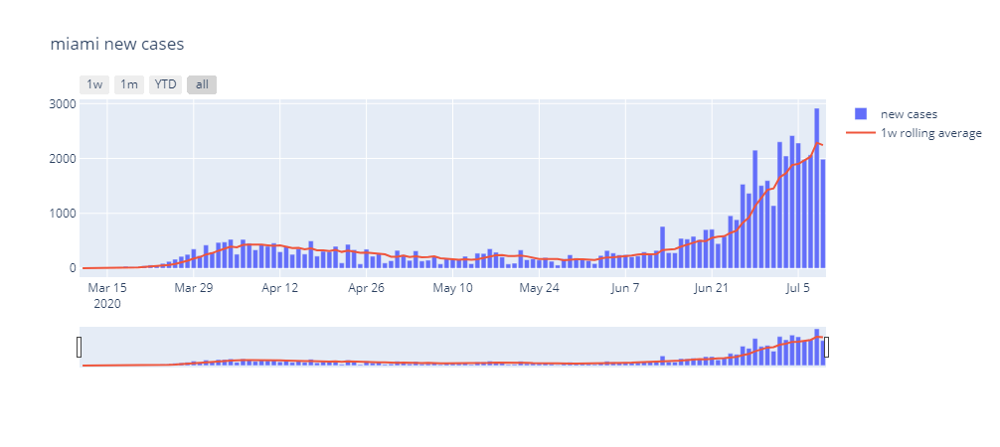

In [73]:
fig = go.Figure()

fig.add_trace(
    go.Bar(x=list(miami['date']), y=list(miami['new_cases']),
           name='new cases')
)

fig.add_trace(
    go.Scatter(x=list(miami['date']), y=list(miami['new_cases_7d']),
               name='1w rolling average')
)

fig.update_layout(
    title_text="miami new cases"
)

fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=7,
                     label='1w',
                     step='day',
                     stepmode='backward'),
                dict(count=1,
                     label='1m',
                     step='month',
                     stepmode='backward'),
                dict(count=1,
                     label='YTD',
                     step='year',
                     stepmode='todate'),
                dict(step='all')
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type='date'
    )
)

fig.show()

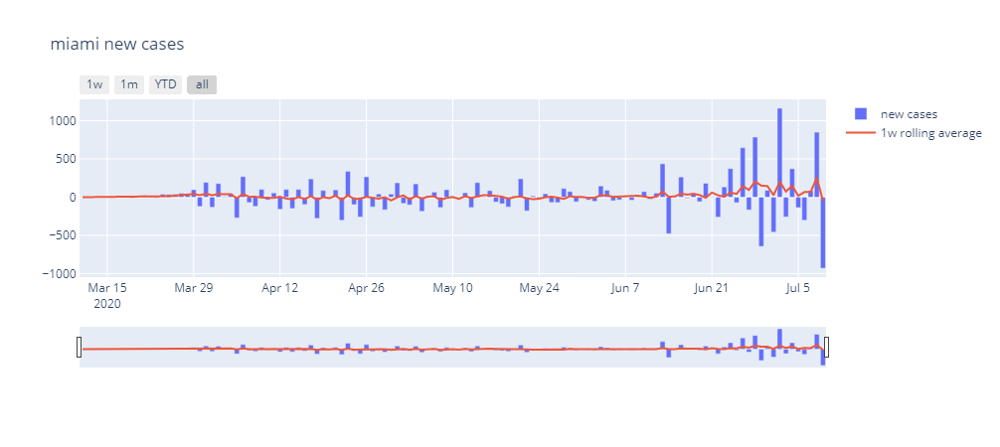

In [74]:
fig = go.Figure()

fig.add_trace(
    go.Bar(x=list(miami['date']), y=list(miami['delta_new_cases']),
           name='new cases')
)

fig.add_trace(
    go.Scatter(x=list(miami['date']), y=list(miami['delta_new_cases_7d']),
               name='1w rolling average')
)

fig.update_layout(
    title_text="miami new cases"
)

fig.update_layout(
    xaxis=dict(
        rangeselector=dict(
            buttons=list([
                dict(count=7,
                     label='1w',
                     step='day',
                     stepmode='backward'),
                dict(count=1,
                     label='1m',
                     step='month',
                     stepmode='backward'),
                dict(count=1,
                     label='YTD',
                     step='year',
                     stepmode='todate'),
                dict(step='all')
            ])
        ),
        rangeslider=dict(
            visible=True
        ),
        type='date'
    )
)

fig.show()

## new cases + change in new cases (7-day rolling average)

In [68]:
df[df['county'] == 'Miami-Dade'][['cases', 'new_cases', 'new_cases_7d', 'delta_new_cases_per_100k','delta_new_cases_per_100k_7d']].tail(20)

,cases,new_cases,new_cases_7d,delta_new_cases_per_100k,delta_new_cases_per_100k_7d
249834,25079,704.0,492.428558,6.698712,-0.299707
252851,25789,710.0,553.285706,0.220837,2.239915
255869,26238,449.0,577.428589,-9.606396,0.888605
258889,26821,583.0,583.000000,4.932019,0.205063
261911,27778,957.0,643.714294,13.765486,2.234657
264939,28663,885.0,687.142883,-2.650040,1.598437
267972,30195,1532.0,831.428589,23.813555,5.310596
271012,31561,1366.0,926.000000,-6.109815,3.480807
274052,33713,2152.0,1132.000000,28.929605,7.582059
277092,35221,1508.0,1283.285767,-23.703136,5.568239


In [69]:
# https://stackoverflow.com/a/46780582

cmax = np.percentile(df_slice['delta_new_cases_per_100k_7d'], 75)
cmax = cmax + (-cmax) % 10

data_slider = []
dates = df.sort_values(by='date')['date'].unique()
for d in dates:
    df_slice = df[df['date'] == d]
    date_data = dict(
        type='scattergeo',
        locationmode = 'geojson-id',
        lon=df_slice['lon'],
        lat=df_slice['lat'],
        marker=dict(
            size=df_slice['new_cases_7d'],
            line=dict(
                width=0.5,
                color='rgb(25,25,25)'
            ),
            colorscale='balance',
            color=df_slice['delta_new_cases_per_100k_7d'],
            cmax=cmax,
            cmid=0,
            cmin=-cmax,
            cauto=False,
            colorbar_title='change in new cases per 100k (7d avg)',
            sizemode='area'
        ),
    )
    data_slider.append(date_data)

steps = []
for i, d in enumerate(dates):
    step = dict(
        method='restyle',
        args=['visible', [False]*len(data_slider)],
        label=f"{np.datetime_as_string(d, unit='D')}"
    )
    step['args'][1][i] = True
    steps.append(step)

sliders = [dict(active=0, pad={'t': 1}, steps=steps)]

layout = dict(
    title='New Cases per County (7-day avg)',
    geo=dict(
        scope='usa',
        projection=go.layout.geo.Projection(type='albers usa')
    ),
    sliders=sliders,
    height=720,
    width=1280
)

fig = dict(data=data_slider, layout=layout)

po.plot(fig)

'temp-plot.html'

In [18]:
df['new_cases_per_100k_7d'].describe()

count    310345.000000
mean          5.880388
std          16.638254
min           0.000000
25%           0.476899
50%           2.157800
75%           5.979249
max        1648.351685
Name: new_cases_per_100k_7d, dtype: float64

In [17]:
x = np.percentile(df['new_cases_per_100k_7d'], 99)
print(x)
x + (-x) % 10

54.65011169433593


60.0

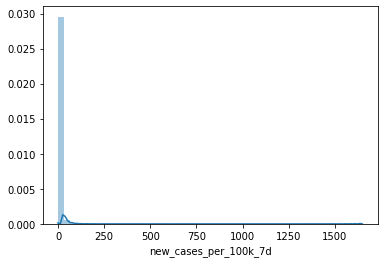

In [25]:
sns.distplot(df['new_cases_per_100k_7d'])

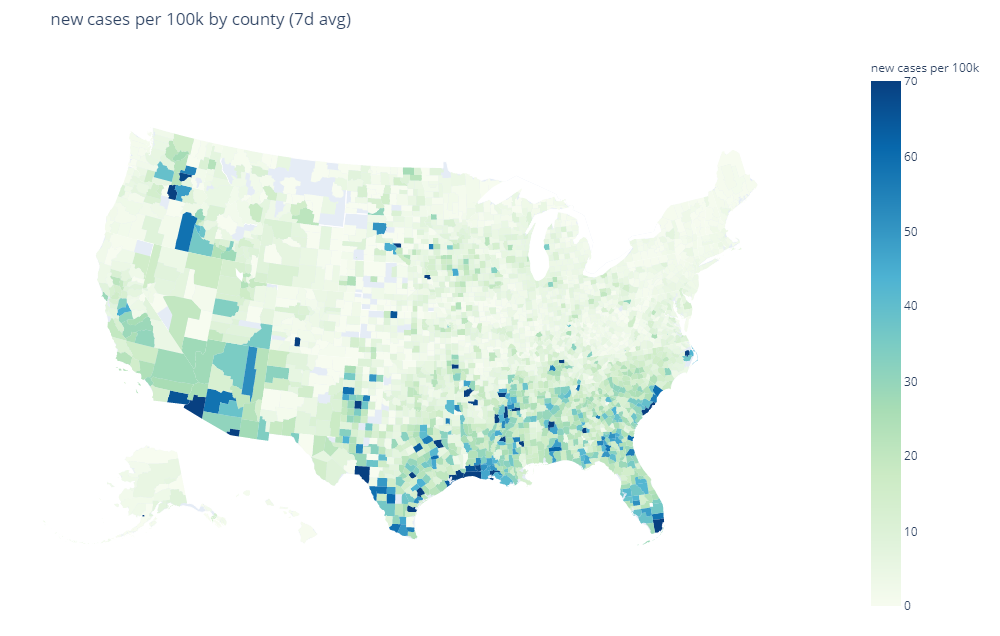

In [30]:
col = 'new_cases_per_100k_7d'
colname = 'new cases per 100k'

z99 = np.percentile(yesterday_df[col], 99)

# tickvals = np.sqrt([25_000, 100_000, 200_000])
# ticktext = ['25k', '100k', '200k']
title_text = 'new cases per 100k by county (7d avg)'

fig = go.Figure(
    data=go.Choropleth(
        colorscale='GnBu',
        colorbar=dict(
            title=colname,
#             tickvals=tickvals,
#             ticktext=ticktext
        ),
        locations=yesterday_df['fips'],
        geojson=county_json,
        marker=dict(
            line={'width':0}
        ),
        z = yesterday_df[col],
        zmin = 0,
        zmax = z99 + (-z99) % 10,
        zauto = False,
        locationmode = 'geojson-id',
        
    )
 )

fig.update_layout(
    showlegend=True,
    title_text=title_text,
    geo_scope='usa',
    height=640,
    width=1080,
    margin={"r":10,"t":50,"l":10,"b":20, 'pad':4}
)

fig.show()

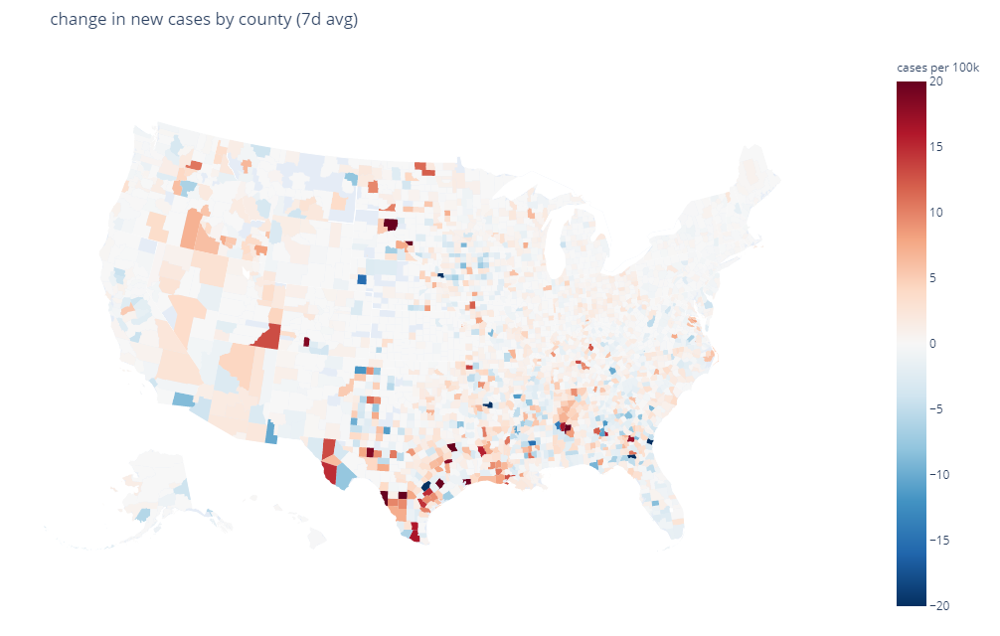

In [31]:
col = 'delta_new_cases_per_100k_7d'
colname = 'cases per 100k'

z1 = np.percentile(yesterday_df[col], 1)
z99 = np.percentile(yesterday_df[col], 99)
zmax = np.max([np.abs(z1), np.abs(z99)])
zmax = zmax + (-zmax) % 10
# tickvals = np.sqrt([25_000, 100_000, 200_000])
# ticktext = ['25k', '100k', '200k']
title_text = 'change in new cases by county (7d avg)'

fig = go.Figure(
    data=go.Choropleth(
        colorscale='RdBu_r',
        colorbar=dict(
            title=colname,
#             tickvals=tickvals,
#             ticktext=ticktext
        ),
        locations=yesterday_df['fips'],
        geojson=county_json,
        marker=dict(
            line={'width':0}
        ),
        z = yesterday_df[col],
        zmin=-zmax,
        zmid=0,
        zmax=zmax,
        zauto=False,
        locationmode = 'geojson-id',
        
    )
 )

fig.update_layout(
    title_text=title_text,
    geo_scope='usa',
    height=640,
    width=1080,
    margin={"r":10,"t":50,"l":10,"b":20, 'pad':4}
)

fig.show()

In [37]:
df['new_cases_per_100k_7d'].describe()

count    310345.000000
mean          5.880388
std          16.638254
min           0.000000
25%           0.476899
50%           2.157800
75%           5.979249
max        1648.351685
Name: new_cases_per_100k_7d, dtype: float64

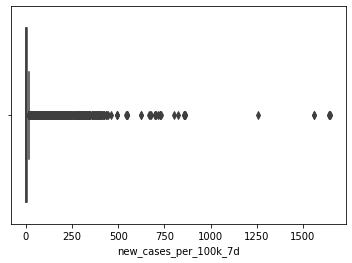

In [36]:
sns.boxplot(df['new_cases_per_100k_7d'])

In [40]:
# https://stackoverflow.com/a/46780582

col = 'new_cases_per_100k_7d'
colname = 'new cases per 100k'
z999 = np.percentile(df[col], 99.9)
z999 = z999 + (-z999) % 100

data_slider = []
dates = df[df['date'].dt.dayofweek == day_of_week].sort_values(by='date')['date'].unique()
for d in dates:
    df_slice = df[df['date'] == d]
    date_data = dict(
        type='choropleth',
        locations=df_slice['fips'],
        geojson=county_json,
        marker={'line':{'width':0}},
        z=df_slice[col],
        zmin=0,
        zmax=z999,
        zauto=False,
        colorscale='GnBu',
        colorbar={
            'title':'new cases per 100k (7d avg)'
            # 'tickvals': np.sqrt([1, 10, 20, 30]),
            # 'ticktext':['1', '10', '20', '30']
        }
    )
    data_slider.append(date_data)

steps = []
for i, d in enumerate(dates):
    step = dict(
        method='restyle',
        args=['visible', [False]*len(data_slider)],
        label=f"{np.datetime_as_string(d, unit='D')}"
    )
    step['args'][1][i] = True
    steps.append(step)

sliders = [dict(active=0, pad={'t': 1}, steps=steps)]

layout = dict(
    title='new cases per 100k residents (7d avg)',
    geo=dict(
        scope='usa',
        projection=go.layout.geo.Projection(type='albers usa')
    ),
    sliders=sliders,
    height=720,
    width=1280
)

fig = dict(data=data_slider, layout=layout)

po.plot(fig)

'temp-plot.html'

In [ ]:
col = 'new_cases_7d'
colname = 'cases'
tickvals = np.sqrt([25_000, 100_000, 200_000])
ticktext = ['25k', '100k', '200k']
title_text = ' by county'

county_slice.loc[:, 'text'] = county_slice.index.get_level_values(1) + '<br>Cases: ' + county_slice['cases'].astype(str)

fig = go.Figure(
    data=go.Scattergeo(
        lon=county_slice['lon'],
        lat=county_slice['lat'],
        text=county_slice['text'],
        marker=dict(
            size=county_slice[col] / 50,
            line={
                'width':0.5,
                'color':'rgb(255,255,255)'
            },
            sizemode='area'
        ),
        locationmode='geojson-id'
    )
 )

fig.update_layout(
    showlegend=True,
    title_text=title_text,
    geo_scope='usa',
    height=640,
    width=1080,
    margin={"r":10,"t":50,"l":10,"b":20, 'pad':4}
)

po.plot(fig)

In [ ]:
col = 'mortality_rate'
colname = 'rate (%)'
tickvals = np.log10(1+ 100 * np.array([0.01, avg_mort_rate, 0.1, 0.25, 0.5]))
ticktext = ['1', '4.82 (avg)', '10', '25', '50']
title_text = 'total mortality rate by county'

county_slice.loc[:, 'mortality_rate'] = county_slice['deaths'] / county_slice['cases']

fig = go.Figure(
    data=go.Choropleth(
        locations=county_slice['fips'],
        geojson=counties,
        text=county_slice['text'],
        marker=dict(
            line={'width':0}
        ),
        zaxis=dict(
            type='log'
        ),
#         z = np.log10(1 + 100 * county_slice[col].astype(float)),
#         hoverinfo=county_slice['text'],
        locationmode = 'geojson-id',
        colorscale='Geyser',
        zmid=np.log10(1 + 100 * avg_mort_rate),
        # zmin=0,
        # zmax=np.sqrt(0.5),
        colorbar=dict(
            title=colname,
            tickvals=tickvals,
            ticktext=ticktext
        )
    )
 )

fig.update_layout(
    title_text=title_text,
    geo_scope='usa',
    height=640,
    width=1080,
)

display(fig)

In [ ]:
col = 'new_cases_7d'
colname = 'new cases'
# tickvals = np.sqrt([25_000, 100_000, 200_000])
# ticktext = ['25k', '100k', '200k']
title_text = 'new cases by county (7d avg)'

fig = go.Figure(
    data=go.Choropleth(
        locations=county_slice['fips'],
        geojson=counties,
        marker=dict(
            line={'width':0}
        ),
        z = county_slice[col].astype(float),
        locationmode = 'geojson-id',
        colorscale='GnBu',
        colorbar=dict(
            title=colname
#             tickvals=tickvals,
#             ticktext=ticktext
        )
    )
 )

fig.update_layout(
    title_text=title_text,
    geo_scope='usa',
)

display(fig)

In [ ]:
county_slice.sort_values(by='new_cases_7d', ascending=False)[['cases', 'new_cases', 'new_cases_7d']].head()

In [ ]:
col = 'new_cp100k_7d'
colname = 'new cases per 100k'
# tickvals = np.sqrt([25_000, 100_000, 200_000])
# ticktext = ['25k', '100k', '200k']
title_text = 'new cases by county per 100k (7d avg)'

fig = go.Figure(
    data=go.Choropleth(
        locations=county_slice['fips'],
        geojson=counties,
        marker=dict(
            line={'width':0}
        ),
        z = county_slice[col].astype(float),
        locationmode = 'geojson-id',
        colorscale='GnBu',
        colorbar=dict(
            title=colname
#             tickvals=tickvals,
#             ticktext=ticktext
        )
    )
 )

fig.update_layout(
    title_text=title_text,
    geo_scope='usa',
)

display(fig)

In [ ]:
county_slice.sort_values(by='cp100k', ascending=False)[['cp100k', 'new_cp100k', 'new_cp100k_7d']].head()

In [ ]:
col = 'new_cd_7d'
colname = 'new cases per 100k per sq. mi.'
# tickvals = np.sqrt([25_000, 100_000, 200_000])
# ticktext = ['25k', '100k', '200k']
title_text = 'new cases by county per 100k per square mile (7d avg)'

fig = go.Figure(
    data=go.Choropleth(
        locations=county_slice['fips'],
        geojson=counties,
        marker=dict(
            line={'width':0}
        ),
        z = county_slice[col].astype(float),
        zmin=0,
        zmax=0.05,
        locationmode = 'geojson-id',
        colorscale='GnBu',
        colorbar=dict(
            title=colname
#             tickvals=tickvals,
#             ticktext=ticktext
        )
    )
 )

fig.update_layout(
    title_text=title_text,
    geo_scope='usa',
    height=640,
    width=1080
)

display(fig)

In [ ]:
county_slice.sort_values(by='new_cd_7d', ascending=False)[['new_cases']].head(50)

In [ ]:
county_slice.loc[('California', 'Los Angeles')]

In [ ]:
data_slider = []
dates = county_df[county_df['date'].dt.dayofweek == day_of_week].sort_values(by='date')['date'].unique()
for d in dates:
    cs = county_df.query('date == @d')
    date_data = dict(
        type='choropleth',
        locations=cs['fips'],
        geojson=counties,
        marker={'line':{'width':0}},
        z=cs['new_cd_7d'].astype(float),
        zmin=0,
        zmax=0.1,
        zauto=False,
        # zmax=800,
        colorscale='GnBu',
        colorbar={
            'title':'new cases per 100k per sq. mi.(7d avg)'
            # 'tickvals': np.sqrt([1, 10, 20, 30]),
            # 'ticktext':['1', '10', '20', '30']
        }
    )
    data_slider.append(date_data)

steps = []
for i, d in enumerate(dates):
    step = dict(
        method='restyle',
        args=['visible', [False]*len(data_slider)],
        label=f"{np.datetime_as_string(d, unit='D')}"
    )
    step['args'][1][i] = True
    steps.append(step)

sliders = [dict(active=0, pad={'t': 1}, steps=steps)]

layout = dict(
    title='new cases per 100k residents per square mile (7d avg)',
    geo=dict(
        scope='usa',
        projection=go.layout.geo.Projection(type='albers usa')
    ),
    sliders=sliders,
    height=720,
    width=1280
)

countyfig = dict(data=data_slider, layout=layout)

po.iplot(countyfig)

In [ ]:
county_slice = county_df[county_df['date'].dt.dayofweek == day_of_week]

fig = go.Figure(
    data=go.Choropleth(
        locations=county_slice['fips'],
        geojson=counties,
        marker=dict(
            line={'width':0}
        ),
        z = county_slice['new_cp100k_7d'].astype(float),
        zmin=0,
        zauto=False,
        locationmode = 'geojson-id',
        colorscale='GnBu',
        colorbar_title='cases'
        )
    )

fig.update_layout(
    title_text = 'new cases by county per 100k (7d avg)',
    geo_scope='usa',
)

display(fig)